
# Import

In [9]:

import os
from collections import defaultdict

import matplotlib.pyplot as plt

from torchmetrics.classification import MulticlassConfusionMatrix

import numpy as np
import torch
import torch.nn.functional as F
import torch.nn as nn
from torch.utils.data import DataLoader, Subset

import pytorch_lightning as pl
from pytorch_lightning.loggers import WandbLogger
from pytorch_lightning.callbacks import ModelCheckpoint

import cv2
from sklearn.model_selection import StratifiedShuffleSplit

from skimage import color
from typing import Optional, Dict
import yaml
import wandb
import timm

import torchvision
from torchvision import datasets
from sklearn.model_selection import StratifiedShuffleSplit
from monai.transforms import (Compose,EnsureChannelFirst,
                              ScaleIntensity,RandZoom, RandRotate90,
                              Rand2DElastic, RandFlip)

# Config

In [10]:
NUM_WORKERS=4
NUM_EPOCHS = 20

NUM_CLASSES = 5
CLASS_WEIGHTS = torch.tensor([0.7140, 0.5517, 0.3039, 1.6141, 1.8163])
PRETRAINED = True

TRAIN_DIR = '/content/UBC_tile_224_500k/train'
VAL_DIR = '/content/UBC_tile_224_500k/validation'
SUBSET=False

In [11]:
config =  {
        "model_name": "resnet50.fb_swsl_ig1b_ft_in1k",
        "drop_rate": 0.5,
        "loss": "cross_entropy",
        "optimizer": "adam",
        'weight_decay': 1e-4,
        'scheduler': 'CosineAnnealingLR',
        "backbone_lr": 1e-6,
        "head_lr": 1e-4,
        "batch_size": 128,
        "augmentation": "heavy"
}

# Setup Data Module and Augmentations

In [16]:
class Dict2Class(object):
    # ToDo: Wrap into RandStainNA
    def __init__(self, my_dict: Dict):
        self.my_dict = my_dict
        for key in my_dict:
            setattr(self, key, my_dict[key])

class RandStainNA(object):
    def __init__(
        self,
        yaml_file: str,
        std_hyper: Optional[float] = 0,
        distribution: Optional[str] = "normal",
        probability: Optional[float] = 1.0,
        is_train: Optional[bool] = True,
    ):
        assert distribution in [
            "normal",
            "laplace",
            "uniform",
        ], "Unsupported distribution style {}.".format(distribution)

        self.yaml_file = yaml_file
        cfg = self._get_yaml_data(self.yaml_file)
        c_s = cfg["color_space"]

        self._channel_avgs = {
            "avg": [
                cfg[c_s[0]]["avg"]["mean"],
                cfg[c_s[1]]["avg"]["mean"],
                cfg[c_s[2]]["avg"]["mean"],
            ],
            "std": [
                cfg[c_s[0]]["avg"]["std"],
                cfg[c_s[1]]["avg"]["std"],
                cfg[c_s[2]]["avg"]["std"],
            ],
        }

        self._channel_stds = {
            "avg": [
                cfg[c_s[0]]["std"]["mean"],
                cfg[c_s[1]]["std"]["mean"],
                cfg[c_s[2]]["std"]["mean"],
            ],
            "std": [
                cfg[c_s[0]]["std"]["std"],
                cfg[c_s[1]]["std"]["std"],
                cfg[c_s[2]]["std"]["std"],
            ],
        }

        self.channel_avgs = Dict2Class(self._channel_avgs)
        self.channel_stds = Dict2Class(self._channel_stds)

        self.p = probability
        self.std_adjust = std_hyper
        self.color_space = c_s
        self.distribution = distribution
        self.is_train = is_train

    def _get_yaml_data(self, yaml_file):
        with open(yaml_file, "r", encoding="utf-8") as file:
            data = yaml.load(file, Loader=yaml.FullLoader)
        return data

    def _create_mask(self, image: np.ndarray, threshold: int = 5) -> np.ndarray:
      """Create a binary mask separating the tissue from the background."""
      grayscale = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
      _, binary_mask = cv2.threshold(grayscale, threshold, 1, cv2.THRESH_BINARY)
      return binary_mask

    def _getavgstd(self, image: np.ndarray, mask: np.ndarray) -> (np.ndarray, np.ndarray):
        avgs = [np.sum(image[:, :, idx] * mask) / np.sum(mask) for idx in range(image.shape[2])]
        masked_image = np.repeat(mask[:, :, np.newaxis], 3, axis=2) * image
        stds = [np.std(masked_image[:, :, idx]) for idx in range(image.shape[2])]
        return np.array(avgs), np.array(stds)

    def _normalize(
        self,
        img: np.ndarray,
        img_avgs: np.ndarray,
        img_stds: np.ndarray,
        tar_avgs: np.ndarray,
        tar_stds: np.ndarray,
    ) -> np.ndarray:

        img_stds = np.clip(img_stds, 0.0001, 255)
        img = (img - img_avgs) * (tar_stds / img_stds) + tar_avgs

        if self.color_space in ["LAB", "HSV"]:
            img = np.clip(img, 0, 255).astype(np.uint8)

        return img

    def _apply_masked_transform(self, image: np.ndarray, mask: np.ndarray, transformed: np.ndarray) -> np.ndarray:
        """Apply the transformation only to the masked region."""
        expanded_mask = np.expand_dims(mask, axis=-1)  # Shape becomes [height, width, 1]
        return image * (1 - expanded_mask) + transformed * expanded_mask


    def augment(self, img):
        # img:is_train:false——>np.array()(cv2.imread()) #BGR
        # img:is_train:True——>PIL.Image #RGB

        if self.is_train == False:
            image = img
        else:
            image = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)

        mask = self._create_mask(image)

        num_of_channel = image.shape[2]

        # color space transfer
        if self.color_space == "LAB":
            image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        elif self.color_space == "HSV":
            image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        elif self.color_space == "HED":
            image = color.rgb2hed(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

        std_adjust = self.std_adjust

        # virtual template generation
        tar_avgs = []
        tar_stds = []
        if self.distribution == "uniform":

            # three-sigma rule for uniform distribution
            for idx in range(num_of_channel):

                tar_avg = np.random.uniform(
                    low=self.channel_avgs.avg[idx] - 3 * self.channel_avgs.std[idx],
                    high=self.channel_avgs.avg[idx] + 3 * self.channel_avgs.std[idx],
                )
                tar_std = np.random.uniform(
                    low=self.channel_stds.avg[idx] - 3 * self.channel_stds.std[idx],
                    high=self.channel_stds.avg[idx] + 3 * self.channel_stds.std[idx],
                )

                tar_avgs.append(tar_avg)
                tar_stds.append(tar_std)
        else:
            if self.distribution == "normal":
                np_distribution = np.random.normal
            elif self.distribution == "laplace":
                np_distribution = np.random.laplace

            for idx in range(num_of_channel):
                tar_avg = np_distribution(
                    loc=self.channel_avgs.avg[idx],
                    scale=self.channel_avgs.std[idx] * (1 + std_adjust),
                )

                tar_std = np_distribution(
                    loc=self.channel_stds.avg[idx],
                    scale=self.channel_stds.std[idx] * (1 + std_adjust),
                )
                tar_avgs.append(tar_avg)
                tar_stds.append(tar_std)

        tar_avgs = np.array(tar_avgs)
        tar_stds = np.array(tar_stds)

        img_avgs, img_stds = self._getavgstd(image, mask)

        transformed_image = self._normalize(
            img=image,
            img_avgs=img_avgs,
            img_stds=img_stds,
            tar_avgs=tar_avgs,
            tar_stds=tar_stds,
        )

        # Now, apply transformation only to tissue regions, keep the black background unchanged
        transformed_image = self._apply_masked_transform(image, mask, transformed_image)

        if self.color_space == "LAB":
            transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_LAB2RGB)
        elif self.color_space == "HSV":
            transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_HSV2BGR)
        elif self.color_space == "HED":
            nimg = color.hed2rgb(transformed_image)
            imin = nimg.min()
            imax = nimg.max()
            rsimg = (255 * (nimg - imin) / (imax - imin)).astype("uint8")  # rescale to [0,255]
            transformed_image = cv2.cvtColor(rsimg, cv2.COLOR_RGB2BGR)

        return transformed_image

    def __call__(self, img):
        if np.random.rand(1) < self.p:
            return self.augment(img)
        else:
            return np.array(img)

    def __repr__(self):
        format_string = self.__class__.__name__ + "("
        format_string += f"methods=Reinhard"
        format_string += f", colorspace={self.color_space}"
        format_string += f", mean={self._channel_avgs}"
        format_string += f", std={self._channel_stds}"
        format_string += f", std_adjust={self.std_adjust}"
        format_string += f", distribution={self.distribution}"
        format_string += f", p={self.p})"
        return format_string

In [17]:
def light_train_transform():
    # Define light augmentation transforms
    return Compose([
        lambda x: np.array(x),
        EnsureChannelFirst(channel_dim=2),
        ScaleIntensity(),
        RandRotate90(prob=0.5),
        RandFlip(prob=0.25, spatial_axis=1),
        RandFlip(prob=0.25, spatial_axis=0),
    ])

def moderate_train_transform():
    return Compose([
        RandStainNA(
            yaml_file="/content/CRC_LAB_randomTrue_n0 (1).yaml",
            std_hyper=-0.15, distribution="normal",
            probability=0.8,
            is_train=True
            ),
        EnsureChannelFirst(channel_dim=2),
        ScaleIntensity(),
        RandRotate90(prob=0.5),
        RandFlip(prob=0.25, spatial_axis=1),
        RandFlip(prob=0.25, spatial_axis=0),
        RandZoom(
            prob=0.1,
            min_zoom=0.8,
            max_zoom=1.2,
            mode = "bilinear",
            padding_mode='reflect'
            ) # Scale augmentation on WSI tile level

    ])

def heavy_train_transform():
    return Compose([
        RandStainNA(
            yaml_file="/content/CRC_LAB_randomTrue_n0 (1).yaml",
            std_hyper=-0.3, distribution="normal",
            probability=0.95,
            is_train=True
            ),
        EnsureChannelFirst(channel_dim=2),
        ScaleIntensity(),
        Rand2DElastic(
            prob=0.5,
            spacing=(10,10),
            magnitude_range=(0.05, 0.5)
            ),
        RandRotate90(prob=0.5),
        RandFlip(prob=0.25, spatial_axis=1),
        RandFlip(prob=0.25, spatial_axis=0),
        RandZoom(
            prob=0.1,
            min_zoom=0.8,
            max_zoom=2,
            mode = "bilinear",
            padding_mode='reflect'
            ), # Scale augmentation on WSI tile level
    ])

def val_transform():
  return Compose([
        lambda x: np.array(x),
        EnsureChannelFirst(channel_dim=2),
        ScaleIntensity(),
    ])

def stratified_subset(dataset, test_size=0.1, random_state=0):
    labels = [label for _, label in dataset.samples]
    sss = StratifiedShuffleSplit(n_splits=1, test_size=test_size, random_state=random_state)

    for _, subset_indices in sss.split(dataset.samples, labels):
        return Subset(dataset, subset_indices)

class ImageFolderClassificationModule(pl.LightningDataModule):
    def __init__(self, config, train_dir, val_dir, subset=False, num_workers=4):
        super().__init__()
        self.config = config
        self.batch_size = config['batch_size']
        self.num_workers = num_workers
        self.train_dir = train_dir
        self.val_dir = val_dir
        self.train_transform, self.val_transform = self._get_transform()
        self.subset = subset

    def _get_transform(self):
        # Choose the correct transform based on config
        if self.config['augmentation'] == 'light':
            return light_train_transform(), val_transform()
        elif self.config['augmentation'] == 'moderate':
            return moderate_train_transform(), val_transform()
        else:
            return heavy_train_transform(), val_transform()

    def prepare_data(self):
        pass

    def setup(self, stage=None):
        full_train_dataset = datasets.ImageFolder(root=self.train_dir, transform=self.train_transform)
        full_val_dataset = datasets.ImageFolder(root=self.val_dir, transform=self.val_transform)

        if self.subset:
            self.train_dataset = stratified_subset(full_train_dataset)
            self.val_dataset = stratified_subset(full_val_dataset)
        else:
            self.train_dataset = full_train_dataset
            self.val_dataset = full_val_dataset

    def train_dataloader(self):
        return DataLoader(self.train_dataset, batch_size=self.batch_size, shuffle=True, num_workers=self.num_workers)

    def val_dataloader(self):
        return DataLoader(self.val_dataset, batch_size=self.batch_size, shuffle=False, num_workers=self.num_workers)


# Display Transforms

In [ ]:
seed = 42
torch.manual_seed(seed)
np.random.seed(seed)

# Instantiate the data module with heavy augmentation
config_heavy = {
    'batch_size': 32,
    'augmentation': 'heavy'
}
data_module_heavy = ImageFolderClassificationModule(config_heavy, TRAIN_DIR, VAL_DIR)
data_module_heavy.prepare_data()
data_module_heavy.setup()

neutral = val_transform()

# Create a dataset for original images (without augmentation)
original_dataset = datasets.ImageFolder(root=TRAIN_DIR, transform=neutral)

# Use the same indices for both datasets to ensure matching pairs
indices = torch.randperm(len(original_dataset)).tolist()

# Create subsets for original and augmented datasets
original_subset = Subset(original_dataset, indices)
augmented_subset = Subset(data_module_heavy.train_dataset, indices)

# Create DataLoaders without shuffling
original_loader = DataLoader(original_subset, batch_size=config_heavy['batch_size'], shuffle=False)
augmented_loader = DataLoader(augmented_subset, batch_size=config_heavy['batch_size'], shuffle=False)

# Fetch one batch of original and augmented images
original_images, _ = next(iter(original_loader))
augmented_images, _ = next(iter(augmented_loader))

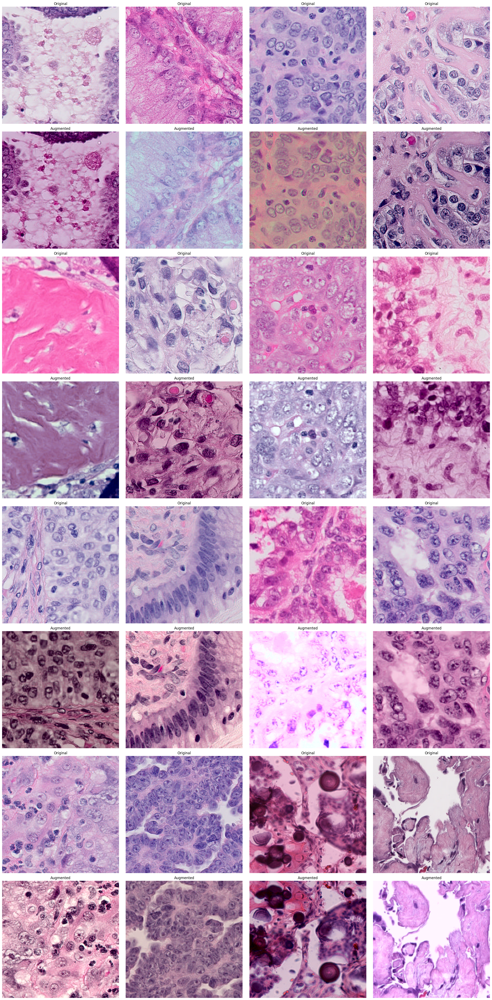

In [ ]:
# Plot original and augmented images
fig, axes = plt.subplots(8, 4, figsize=(24, 48))  # 32 rows, 4 columns for 32 images

for i in range(4):  # 8 pairs of rows
    for j in range(4):  # 4 images per pair of rows
        index = i * 4 + j   # Calculate index for image in the batch

        # Calculate row for original and augmented images
        row_orig = 2 * i
        row_aug = 2 * i + 1

        # Plot original images in one row
        axes[row_orig, j].imshow(torchvision.transforms.ToPILImage()(original_images[index]))
        axes[row_orig, j].set_title("Original")
        axes[row_orig, j].axis('off')

        # Plot corresponding augmented images in the next row
        axes[row_aug, j].imshow(torchvision.transforms.ToPILImage()(augmented_images[index]))
        axes[row_aug, j].set_title("Augmented")
        axes[row_aug, j].axis('off')

plt.tight_layout()
plt.show()

# Setup Custom Loss Function and Calculate Class Weights

In [19]:
# Counting files in each directory
class_counts = defaultdict(int)
for class_dir in os.listdir(TRAIN_DIR):
    class_dir_path = os.path.join(TRAIN_DIR, class_dir)
    if os.path.isdir(class_dir_path):
        class_counts[class_dir] = len(os.listdir(class_dir_path))

# Convert to list and sort by class index if necessary
class_counts_list = [class_counts[class_name] for class_name in sorted(class_counts)]

# Calculate class weights
class_weights = [1.0 / count for count in class_counts_list]
total = sum(class_weights)
class_weights = [weight / total * len(class_counts_list) for weight in class_weights]

# Convert to Tensor
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float)
print(class_weights_tensor)

tensor([0.7140, 0.5517, 0.3039, 1.6141, 1.8163])


In [20]:
class FocalLoss(nn.Module):
    '''
    Multi-class Focal Loss
    '''
    def __init__(self, gamma=2, weight=None):
        super(FocalLoss, self).__init__()
        self.gamma = gamma
        if weight is not None:
            self.register_buffer('weight', weight)  # Register weight as a buffer, not a parameter
        else:
            self.weight = None  # Handle the case when weight is None

    def forward(self, input, target):
        """
        input: [N, C], float32
        target: [N, ], int64
        """
        if input.device != self.weight.device:
            self.weight = self.weight.to(input.device)
        logpt = F.log_softmax(input, dim=1)
        pt = torch.exp(logpt)
        logpt = (1-pt)**self.gamma * logpt
        loss = F.nll_loss(logpt, target, self.weight)
        return loss

# Setup Pytorch Lightning Model Module

In [21]:
class CustomModel(pl.LightningModule):
    def __init__(self, config, pretrained=True, num_classes=5, weight=None):
        super().__init__()
        self.config = config
        self.pretrained = pretrained
        self.num_classes = num_classes
        self.model = self.create_model()
        self.criterion = self.set_criterion(weight)
        self.mcm = MulticlassConfusionMatrix(num_classes)


    def set_criterion(self, weight):
        if self.config['loss'] == 'focal':
            return FocalLoss(weight)
        elif self.config['loss'] == 'cross_entropy':
            return nn.CrossEntropyLoss(weight=weight)

    def create_model(self):
        # Create the model using timm
        model = timm.create_model(
            self.config['model_name'],
            pretrained=self.pretrained,
            num_classes=self.num_classes,
            drop_rate = self.config['drop_rate']
            )
        return model


    def balanced_accuracy(self, y_true, y_pred):
        C = self.mcm(y_pred, y_true)
        per_class = torch.diag(C) / C.sum(axis=1)
        if torch.any(torch.isnan(per_class)):
            per_class = per_class[~torch.isnan(per_class)]
        score = per_class.mean()

        return score


    def forward(self, x):
        return self.model(x)

    def training_step(self, batch, batch_idx):
        x, y = batch
        logits = self(x)
        loss = self.criterion(logits, y)

        preds = torch.argmax(logits, dim=1)
        balanced_acc = self.balanced_accuracy(y, preds)

        self.log('train_loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.log('train_balanced_accuracy', balanced_acc, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        logits = self(x)
        loss = self.criterion(logits, y)

        preds = torch.argmax(logits, dim=1)
        balanced_acc = self.balanced_accuracy(y, preds)

        self.log('val_loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.log('val_balanced_accuracy', balanced_acc, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        return loss


    def configure_optimizers(self):
        # Separate parameters for the backbone and the head
        backbone_parameters = [p for name, p in self.model.named_parameters() if not name.startswith('head')]
        head_parameters = [p for name, p in self.model.named_parameters() if name.startswith('head')]

        # Learning rates from config
        backbone_lr = self.config['backbone_lr']
        head_lr = self.config['head_lr']

        # Optimizer selection
        optimizer_type = self.config['optimizer']
        weight_decay = self.config['weight_decay']
        if optimizer_type == 'adam':
            optimizer = torch.optim.Adam([
                {'params': backbone_parameters, 'lr': backbone_lr},
                {'params': head_parameters, 'lr': head_lr}
            ], weight_decay=weight_decay)
        elif optimizer_type == 'adamw':
            optimizer = torch.optim.AdamW([
                {'params': backbone_parameters, 'lr': backbone_lr},
                {'params': head_parameters, 'lr': head_lr}
            ], weight_decay=weight_decay)
        else:
            raise ValueError(f"Unsupported optimizer type: {optimizer_type}")

        scheduler_type = self.config['scheduler']
        if scheduler_type == 'StepLR':
            scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=30, gamma=0.1)
        elif scheduler_type == 'ExponentialLR':
            scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.9)
        elif scheduler_type == 'CosineAnnealingLR':
            scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=50, eta_min=0)
        else:
            raise ValueError(f"Unsupported scheduler type: {scheduler_type}")

        return {"optimizer": optimizer, "lr_scheduler": scheduler}

# Setup Training

In [49]:
# Create the DataModule and Model
data_module = ImageFolderClassificationModule(config, train_dir=TRAIN_DIR, val_dir=VAL_DIR, subset=SUBSET, num_workers=NUM_WORKERS)
model = CustomModel(config, pretrained=PRETRAINED, num_classes=NUM_CLASSES, weight=CLASS_WEIGHTS)

In [50]:
wandb_logger = WandbLogger(name="test_run_7", project="UBC_tile_classification")

In [51]:
# Initialize the ModelCheckpoint callback to save the best checkpoints
checkpoint_callback = ModelCheckpoint(
    monitor='val_balanced_accuracy',  # Replace with your validation loss or other metric
    dirpath='../models/UBC_classification_models',
    filename='best-checkpoint-{epoch:02d}-{val_balanced_accuracy:.2f}',
    save_top_k=1,  # Save only the best checkpoint
    mode='max',  # Change to 'max' if it's a metric that should be maximized
)

In [52]:
trainer = pl.Trainer(
    max_epochs=NUM_EPOCHS,
    check_val_every_n_epoch=1,
    log_every_n_steps=100,
    logger=wandb_logger,
    callbacks=[checkpoint_callback],
    accelerator='auto'
    )

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
# Train the model
trainer.fit(model, datamodule=data_module)

wandb: Currently logged in as: jonasgg (gggggggggggg). Use `wandb login --relogin` to force relogin


/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:639: Checkpoint directory /content/drive/MyDrive/models/UBC_classification_models exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type                      | Params
--------------------------------------------------------
0 | model     | ResNet                    | 23.5 M
1 | criterion | CrossEntropyLoss          | 0     
2 | mcm       | MulticlassConfusionMatrix | 0     
--------------------------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
94.073    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

In [ ]:
trainer.save_checkpoint("first_tile_checkpoint.ckpt")